In [2]:
import h5py as h5
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

In [3]:
fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(2, 2)

In [4]:
# given the position and masses of the particles, finds their center of mass
def findCenterMass(r,m):
    com=np.zeros(3)
    for i in range(3):
        com[i]=np.sum(r[:,i]*m[:])/np.sum(m[:])
    return com

# Merger Text File

In [5]:
#Begin Jacob's method for doing shit
end = 402
snap = np.arange(0,end)
blah = []

for x in (snap):
    if x == 0:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
        
        header = filein['Header']
        stars = filein['PartType2']
        s_positions = np.asarray(stars['Coordinates'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        gas = filein['PartType0']
        g_positions = np.asarray(gas['Coordinates'])
        g_mass = np.asarray(gas['Mass'])
        Gcom = findCenterMass(g_positions,g_mass)
    else:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    
        header = filein['Header']
        stars = filein['PartType2']
        nstars = filein['PartType4']
        gas = filein['PartType0']
        g_positions = np.asarray(gas['Coordinates'])
        g_mass = np.asarray(gas['Mass'])
        s_positions = np.asarray(stars['Coordinates'])
        n_positions = np.asarray(nstars['Coordinates'])
        n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
    
        Gcom = findCenterMass(np.concatenate((s_positions,n_positions),axis=0),np.concatenate((s_mass,n_mass),axis=0))
        
    blah.append([x, Gcom[0], Gcom[1], Gcom[2]])

np.savetxt('centerofmassgas.txt',blah , fmt = '%10.5f', header='snapshot x y z')

# No Merger Text File

In [5]:
end = 402
snap = np.arange(0,end)
blah = []

for x in (snap):
    if x == 0:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/noMerger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
        
        header = filein['Header']
        stars = filein['PartType2']
        s_positions = np.asarray(stars['Coordinates'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        
        Gcom = findCenterMass(s_positions,s_mass)
    else:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/noMerger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    
        header = filein['Header']
        stars = filein['PartType2']
        nstars = filein['PartType4']
        s_positions = np.asarray(stars['Coordinates'])
        n_positions = np.asarray(nstars['Coordinates'])
        n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
    
        Gcom = findCenterMass(np.concatenate((s_positions,n_positions),axis=0),np.concatenate((s_mass,n_mass),axis=0))
        
    blah.append([x, Gcom[0], Gcom[1], Gcom[2]])

np.savetxt('centerofmass-nomerger.txt',blah , fmt = '%10.5f', header='snapshot x y z [kpc/h]')

# BH positions Merger Text File

In [6]:
gin=[]
for x in snap:
    filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    BH = filein['PartType5']
    BH_positions = np.asarray(BH['Coordinates'])
    BH_mass = np.asarray(BH['BH_Mass'])   
    
    
    gin.append([x, BH_positions[0,0], BH_positions[0,1], BH_positions[0,2]])
np.savetxt('BHpositions.txt', gin, fmt ='%10.5f', header='snapshot x y z [kpc/h]')

# BH positions No Merger Text File

In [7]:
gin=[]
for x in snap:
    filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/noMerger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    BH = filein['PartType5']
    BH_positions = np.asarray(BH['Coordinates'])
    BH_mass = np.asarray(BH['BH_Mass'])   
    
    
    gin.append([x, BH_positions[0,0], BH_positions[0,1], BH_positions[0,2]])
np.savetxt('BHpositions-nomerger.txt', gin, fmt ='%10.5f', header='snapshot x y z [kpc/h]')

# Separation  between BH and COM vs Time

In [5]:
# Takes every row in d(an array with zeroes) and gives out ds(distance between the Com and BH)
def Distance(cm,bh):
    d = np.zeros((402,1))                  #creates a column with 401 elements of zeroes
    for row in d:                          #for every row of d it calculates the dx,dy and dz of each row 
        dx = bh[:,0]-cm[:,0]
        dy = bh[:,1]-cm[:,1]
        dz = bh[:,2]-cm[:,2]
        
        ds = np.sqrt(dx**2 + dy**2 +dz**2) #ds is calculated for each row and put back into d
    return ds

In [6]:
cm = np.loadtxt('centerofmass.txt',usecols=[1,2,3])

In [ ]:
bh = np.loadtxt('BHpositions.txt',usecols=[1,2,3])
Distance(cm,bh)
snapshots = np.arange(0,402)

In [11]:
np.savetxt('distances.txt', Distance(cm,bh), fmt = '%10.5f', header='distance [kpc/h]')

In [ ]:
p = plt.gca()
p.plot(snapshots,(Distance(cm,bh)/0.73),'k-',lw=1)
p.set_xlim(0,402)
p.set_xlabel('10${^7}$ yr')
p.set_ylabel('Distance between CoM and BH [kpc $h^{-1}$]')
p.set_title('Center of Mass and BH Separation')
plt.savefig('CoM-BH Separation-Merger')

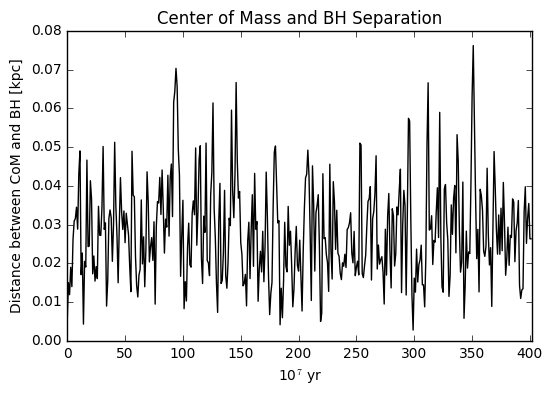

In [13]:
cm1 = np.loadtxt('centerofmassnomerger.txt',usecols=[1,2,3])
bh1 = np.loadtxt('BHpositionsnomerger.txt', usecols=[1,2,3])
p = Distance(cm1,bh1)


np.savetxt('distances-nomerger.txt', p, fmt = '%10.5f', header='distance [kpc]')

plt.plot(snapshots,(p/0.73),'k-')
plt.xlim(0,402)
plt.xlabel('10${^7}$ yr')
plt.ylabel('Distance between CoM and BH [kpc]')
plt.title('Center of Mass and BH Separation')
plt.savefig('CoM-BH Separation-noMerger')

# Time at Max accretion is 4.07 Gyr so snapshot 400-401, Plot with Stars or Gas and superimpose the BH at that time. (For Merger)

In [14]:
filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_401/snap_401.hdf5",'r')
# filein1 = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_401/snap_401.hdf5",'r')

header = filein['Header']
gas = filein['PartType0']
stars = filein['PartType2']
nstars = filein['PartType4']
g_positions = np.asarray(gas['Coordinates'])
s_positions = np.asarray(stars['Coordinates'])
n_positions = np.asarray(nstars['Coordinates'])
n_mass = np.asarray(nstars['Mass'])
s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
BH = filein['PartType5']
BH_positions = np.asarray(BH['Coordinates'])

bhx = BH_positions[:,0] / 0.73
bhy = BH_positions[:,1] / 0.73
bhz = BH_positions[:,2] / 0.73
gx = g_positions[:,0] / 0.73
gy = g_positions[:,1] / 0.73
gz = g_positions[:,2] / 0.73
sx = s_positions[:,0] / 0.73
sy = s_positions[:,1] / 0.73
sz = s_positions[:,2] / 0.73


# header1 = filein1['Header']
# gas1 = filein['PartType0']
# stars1 = filein1['PartType2']
# nstars1 = filein1['PartType4']
# g_positions1 = np.asarray(gas1['Coordinates'])
# s_positions1 = np.asarray(stars1['Coordinates'])
# n_positions1 = np.asarray(nstars1['Coordinates'])
# n_mass1 = np.asarray(nstars1['Mass'])
# s_mass1 = np.ones(500000)*(header1.attrs.__getitem__('MassTable')[2])
# BH1 = filein1['PartType5']
# BH_positions1 = np.asarray(BH1['Coordinates'])

# bhx1 = BH_positions1[:,0]
# bhy1 = BH_positions1[:,1]
# bhz1 = BH_positions1[:,2]
# gx1 = g_positions1[:,0]
# gy1 = g_positions1[:,1]
# gz1 = g_positions1[:,2]
# sx1 = s_positions1[:,0]
# sy1 = s_positions1[:,1]
# sz1 = s_positions1[:,2]
    
# Gcom = findCenterMass(np.concatenate((s_positions,n_positions),axis=0),np.concatenate((s_mass,n_mass),axis=0))

# Merger w/ Mdot Highest(400) [Gas] and [Stars]

In [15]:
# fig = plt.figure(figsize=(14,14))
# gs = gridspec.GridSpec(2, 2)

# p0 = fig.add_subplot(gs[0,0])
# p0.scatter(gx,gy,s=1,c='y', alpha=0.7)
# p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,120), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# p1 = fig.add_subplot(gs[0,1])
# p1.scatter(gy,gz,c='y',s=1, alpha=0.7)
# p1.annotate('BH', xy=(bhy, bhz), xytext=(-20,120), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# p2 = fig.add_subplot(gs[1,0])
# p2.scatter(gx,gz,s=1,c='y', alpha=0.7)
# p2.annotate('BH', xy=(bhx, bhz), xytext=(-20,120), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# ax = fig.add_subplot(gs[1,1], projection='3d')
# ax.scatter(gx,gy,gz, s=1, c='y', depthshade = 0.5)
# ax.annotate('BH', xy=(bhx, bhy), xytext=(-20,20), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))

# # ax.set_xlim3d(-25,25)
# # ax.set_ylim3d(-45,45)
# # ax.set_zlim3d(-25,25)
# plt.suptitle('Merger w/ Mdot Highest(400) [Gas]', y = 0.92)
# plt.savefig('Mdot Highest400 Gas')

# fig1 = plt.figure(figsize=(14,14))
# gs1 = gridspec.GridSpec(2, 2)

# p0 = fig1.add_subplot(gs1[0,0])
# p0.scatter(sx,sy,s=0.5,c='c', alpha = 0.3)
# p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,-5), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))# p0.set_xlim(-400,400)
# # p0.set_ylim(-400,400)
# p1 = fig1.add_subplot(gs1[0,1])
# p1.scatter(sy,sz,s=0.5,c='c', alpha = 0.3)
# p1.set_ylim(-25,25)
# p1.annotate('BH', xy=(bhy, bhz), xytext=(-20,20), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# p2 = fig1.add_subplot(gs1[1,0])
# p2.scatter(sx,sz,s=0.5,c='c', alpha = 0.3)
# p2.set_ylim(-25,25)
# p2.annotate('BH', xy=(bhx, bhz), xytext=(-20,20), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# ax = fig1.add_subplot(gs1[1,1], projection='3d')
# ax.scatter(sx,sy,sz, s=0.5, c='c', depthshade = 5)
# ax.set_xlim3d(-25,15)
# # ax.set_ylim3d(-45,45)
# ax.set_zlim3d(-25,25)
# plt.suptitle('Merger w/ Mdot Highest(400) [Stars]', y = 0.92)
# plt.savefig('Mdot Highest400 Stars')

# Merger w/ Mdot Highest(401) [Gas] and [Stars]

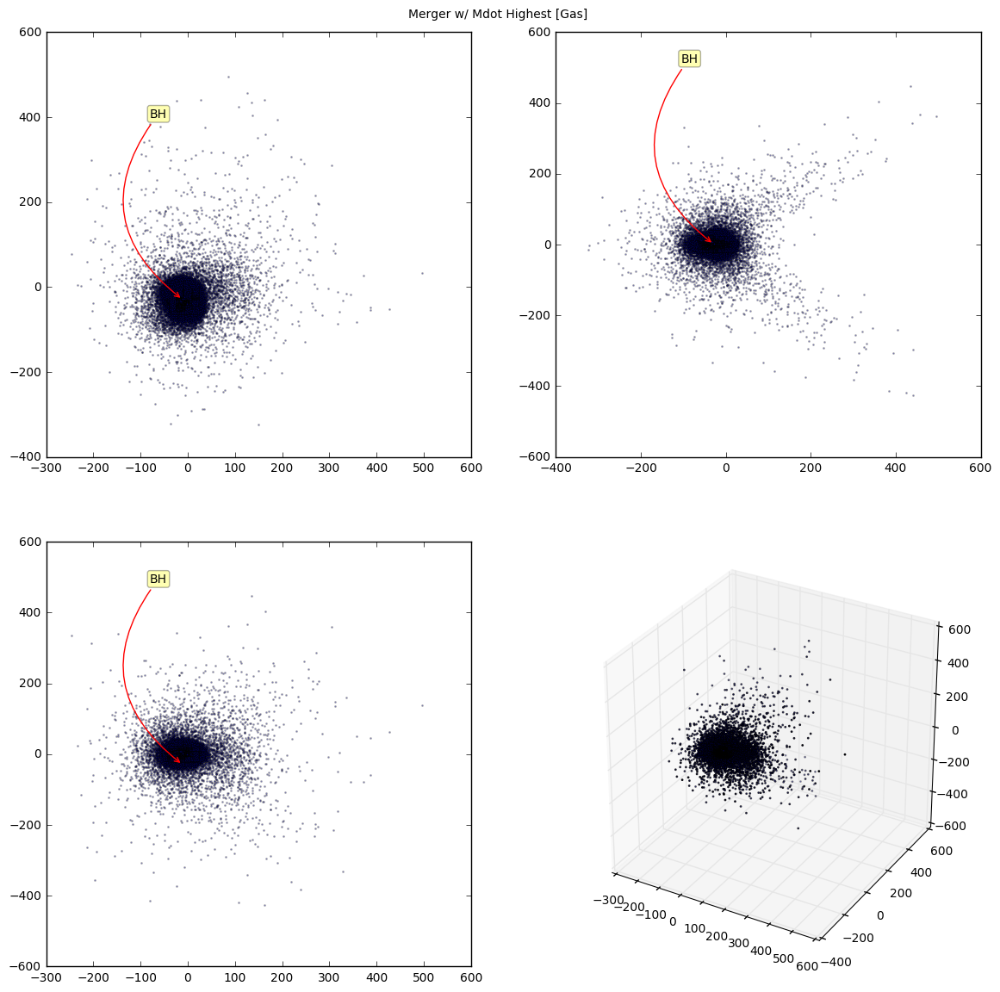

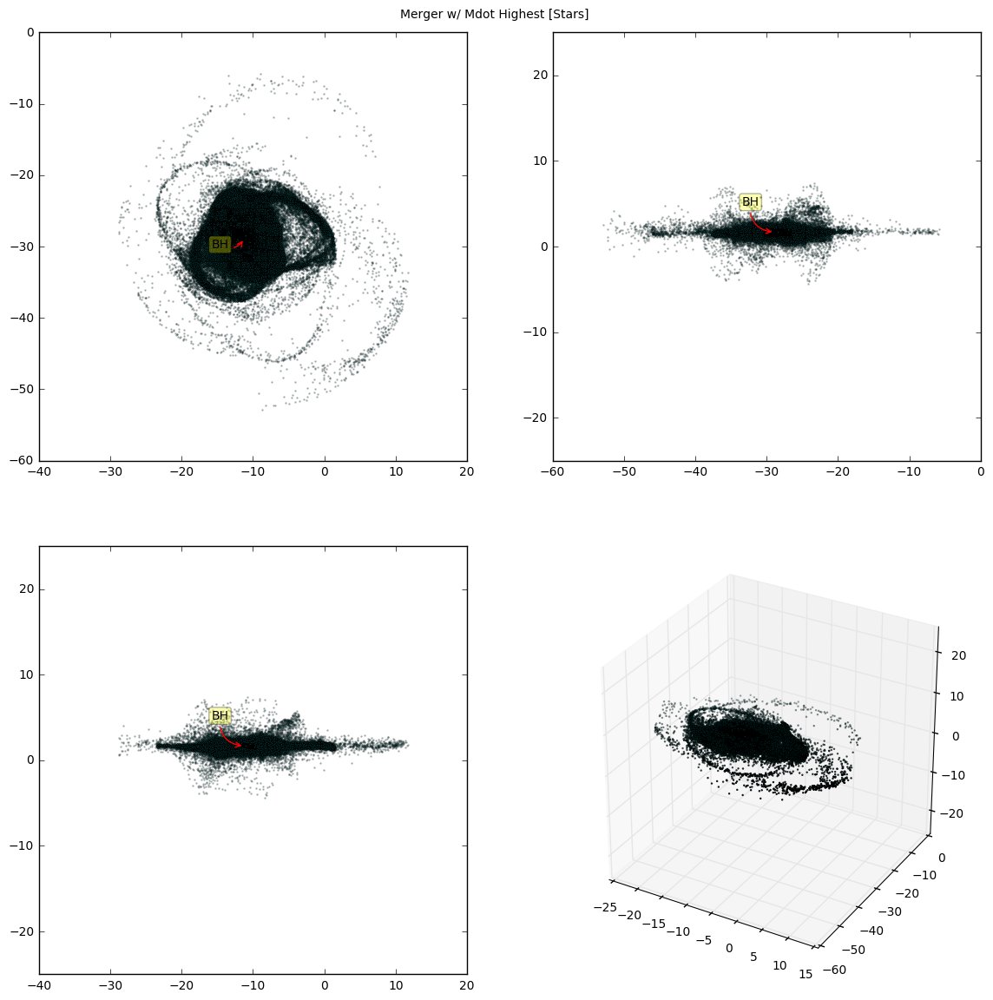

In [16]:
fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(2, 2)

p0 = fig.add_subplot(gs[0,0])
p0.scatter(gx,gy,s=1,c='b', alpha=0.3)
p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p0.set_xlim(-400,400)
# p0.set_ylim(-400,400)
p1 = fig.add_subplot(gs[0,1])
p1.scatter(gy,gz,s=1,c='b', alpha=0.3)
p1.annotate('BH', xy=(bhy, bhz), xytext=(-20,150), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p1.set_ylim(-25,25)
p2 = fig.add_subplot(gs[1,0])
p2.scatter(gx,gz,s=1,c='b', alpha=0.3)
p2.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p2.set_ylim(-25,25)
ax = fig.add_subplot(gs[1,1], projection='3d')
ax.scatter(gx,gy,gz, s=1, c='b', depthshade = 5)
# ax.set_xlim3d(-25,25)
# ax.set_ylim3d(-45,45)
# ax.set_zlim3d(-25,25)
plt.suptitle('Merger w/ Mdot Highest [Gas]', y = 0.92)
plt.savefig('Mdot Highest Gas')

fig1 = plt.figure(figsize=(14,14))
gs1 = gridspec.GridSpec(2, 2)

p0 = fig1.add_subplot(gs1[0,0])
p0.scatter(sx,sy,s=0.5,c='c', alpha = 0.3)
p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,-10), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p0.set_xlim(-400,400)
# p0.set_ylim(-400,400)
p1 = fig1.add_subplot(gs1[0,1])
p1.scatter(sy,sz,s=0.5,c='c', alpha = 0.3)
p1.set_ylim(-25,25)
p1.annotate('BH', xy=(bhy, bhz), xytext=(-20,20), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
p2 = fig1.add_subplot(gs1[1,0])
p2.scatter(sx,sz,s=0.5,c='c', alpha = 0.3)
p2.set_ylim(-25,25)
p2.annotate('BH', xy=(bhx, bhz), xytext=(-20,20), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
ax = fig1.add_subplot(gs1[1,1], projection='3d')
ax.scatter(sx,sy,sz, s=0.5, c='c', depthshade = 5)
ax.set_xlim3d(-25,15)
# ax.set_ylim3d(-45,45)
ax.set_zlim3d(-25,25)
plt.suptitle('Merger w/ Mdot Highest [Stars]', y = 0.92)
plt.savefig('Mdot Highest Stars')

# Merger w/ Separation CoM-BH highest [Gas] and [Stars]

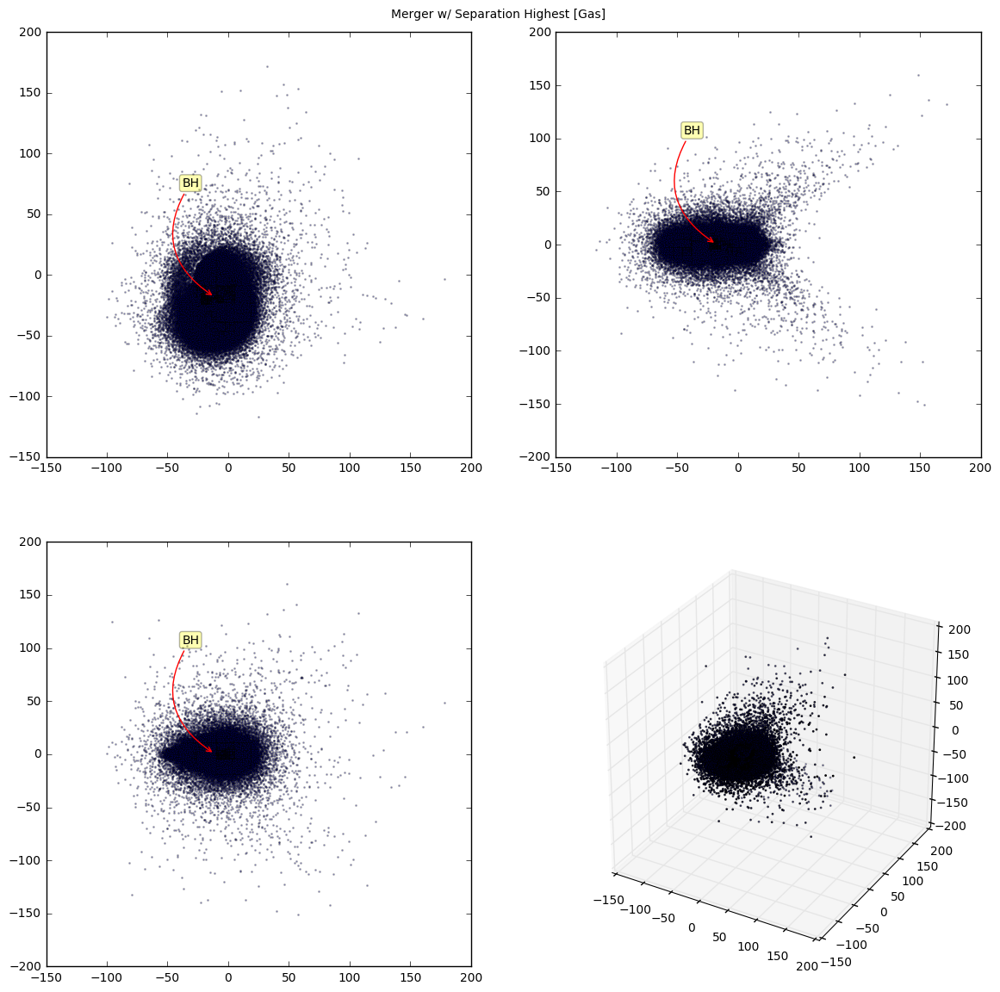

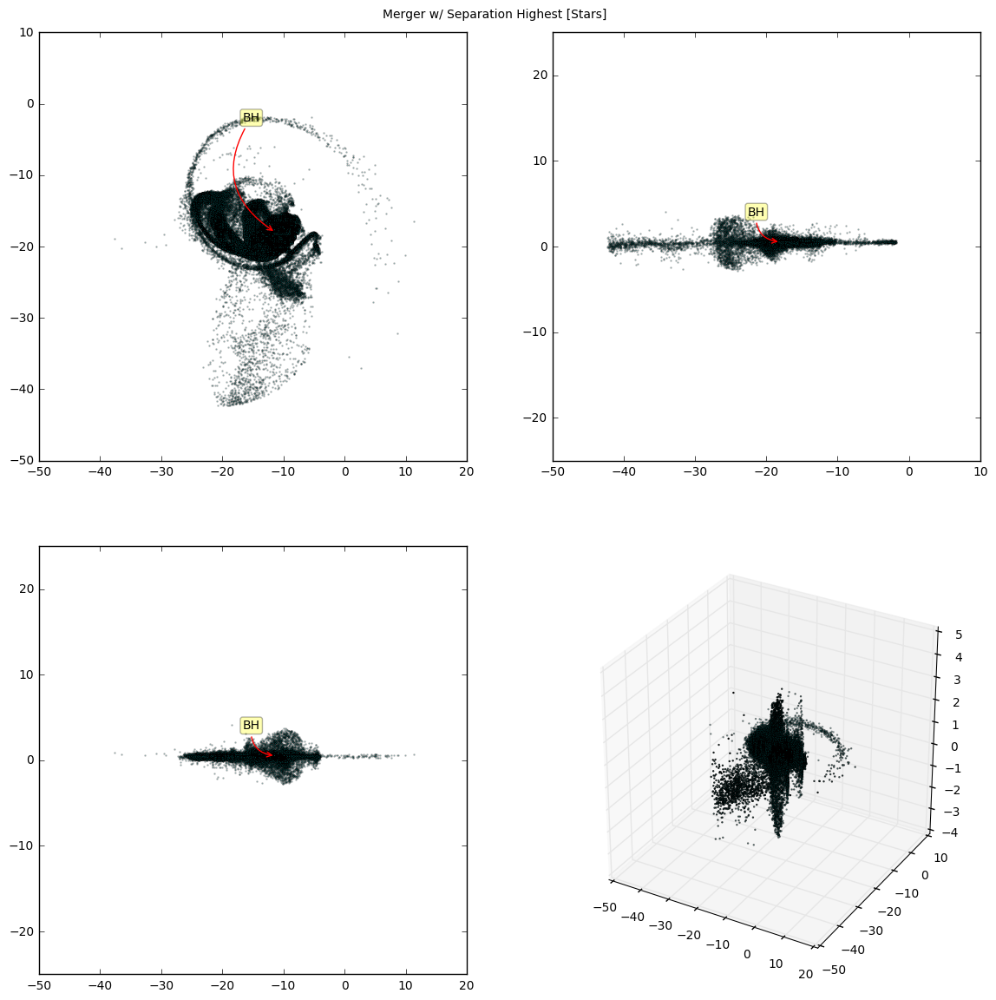

In [4]:
filein1 = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_218/snap_218.hdf5",'r')

header1 = filein1['Header']
gas1 = filein1['PartType0']
stars1 = filein1['PartType2']
nstars1 = filein1['PartType4']
g_positions1 = np.asarray(gas1['Coordinates'])
s_positions1 = np.asarray(stars1['Coordinates'])
n_positions1 = np.asarray(nstars1['Coordinates'])
n_mass1 = np.asarray(nstars1['Mass'])
s_mass1 = np.ones(500000)*(header1.attrs.__getitem__('MassTable')[2])
BH1 = filein1['PartType5']
BH_positions1 = np.asarray(BH1['Coordinates'])

bhx1 = BH_positions1[:,0] / 0.73
bhy1 = BH_positions1[:,1] / 0.73
bhz1 = BH_positions1[:,2] / 0.73
gx1 = g_positions1[:,0] / 0.73
gy1 = g_positions1[:,1] / 0.73
gz1 = g_positions1[:,2] / 0.73
sx1 = s_positions1[:,0] / 0.73
sy1 = s_positions1[:,1] / 0.73
sz1 = s_positions1[:,2] / 0.73


fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(2, 2)

p0 = fig.add_subplot(gs[0,0])
p0.scatter(gx1,gy1,s=1,c='b', alpha=0.3)
p0.annotate('BH', xy=(bhx1, bhy1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p0.set_xlim(-400,400)
# p0.set_ylim(-400,400)
p1 = fig.add_subplot(gs[0,1])
p1.scatter(gy1,gz1,s=1,c='b', alpha=0.3)
p1.annotate('BH', xy=(bhy1, bhz1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p1.set_ylim(-25,25)
p2 = fig.add_subplot(gs[1,0])
p2.scatter(gx1,gz1,s=1,c='b', alpha=0.3)
p2.annotate('BH', xy=(bhx1, bhz1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p2.set_ylim(-25,25)
ax = fig.add_subplot(gs[1,1], projection='3d')
ax.scatter(gx1,gy1,gz1, s=1, c='b', depthshade = 5)
# ax.set_xlim3d(-25,25)
# ax.set_ylim3d(-45,45)
# ax.set_zlim3d(-25,25)
plt.suptitle('Merger w/ Separation Highest [Gas]', y = 0.92)
plt.savefig('Separation Highest Gas')

fig2 = plt.figure(figsize=(14,14))
gs2 = gridspec.GridSpec(2, 2)

p0 = fig2.add_subplot(gs2[0,0])
p0.scatter(sx1,sy1,s=0.5,c='c', alpha = 0.3)
p0.annotate('BH', xy=(bhx1, bhy1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p0.set_xlim(-400,400)
# p0.set_ylim(-400,400)
p1 = fig2.add_subplot(gs2[0,1])
p1.scatter(sy1,sz1,s=0.5,c='c', alpha = 0.3)
p1.set_ylim(-25,25)
p1.annotate('BH', xy=(bhy1, bhz1), xytext=(-20,20), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
p2 = fig2.add_subplot(gs2[1,0])
p2.scatter(sx1,sz1,s=0.5,c='c', alpha = 0.3)
p2.set_ylim(-25,25)
p2.annotate('BH', xy=(bhx1, bhz1), xytext=(-20,20), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
ax = fig2.add_subplot(gs2[1,1], projection='3d')
ax.scatter(sx1,sy1,sz1, s=0.5, c='c', depthshade = 5)
# ax.set_xlim3d(-25,15)
# ax.set_ylim3d(-45,45)
# ax.set_zlim3d(-25,25)
plt.suptitle('Merger w/ Separation Highest [Stars]', y = 0.92)
plt.savefig('Separation Highest Stars')

In [5]:
# fig = plt.figure()
# ax = fig.add_subplot(111)
# ax.hist2d(sx2,sy2, bins=999)
# # im = ax.imshow(H, cmap=plt.cm.jet, extent=extent)
# plt.show()
# # H = np.histogram2d(sx2, sy2, bins=10, range=None, normed=False, weights=None)

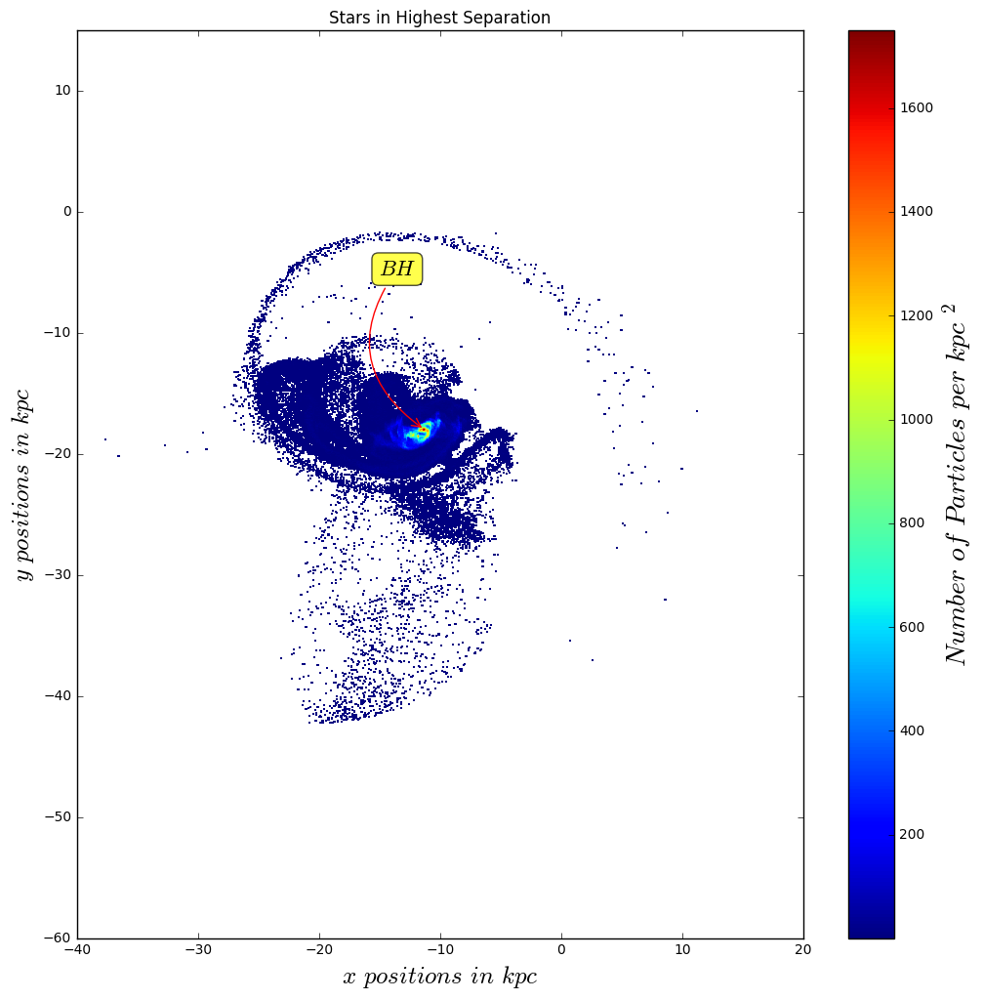

In [6]:
# Estimate the 2D histogram
nbins = 500
H, xedges, yedges = np.histogram2d(sx1,sy1,bins=nbins)
# H is histogram, 

# H needs to be rotated and flipped
H = np.rot90(H)
H = np.flipud(H)

# Mask zeros
Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero
 
# Plot 2D histogram using pcolor
fig2 = plt.figure(figsize=(12,12))
plt.pcolormesh(xedges,yedges,Hmasked)
#pcolormesh shows actual edges
plt.xlabel('$x$ $positions$ $in$ $kpc$', size = 18)
plt.ylabel('$y$ $positions$ $in$ $kpc$', size = 18)
# plt.ylim(-15,-5)
# plt.xlim(-15,-5)
plt.axis('equal')
plt.annotate('$BH$', xy=(bhx1, bhy1), xytext=(-20,111), 
             fontsize=16,textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
plt.title('Stars in Highest Separation')
cbar = plt.colorbar()
cbar.ax.set_ylabel('$Number$ $ of$ $ Particles$ $per$ $kpc$ $^{2}$', fontsize= 20)
plt.savefig('StarsinHighestSep')

In [20]:
sfr2 = np.asarray(gas1['StarFormationRate'])
pos2 = np.asarray(gas1['Coordinates'])
#sfr1 = np.where(sfr2>0)
sfr = sfr2[(sfr2>0)]
pos = pos2[(sfr2>0)]

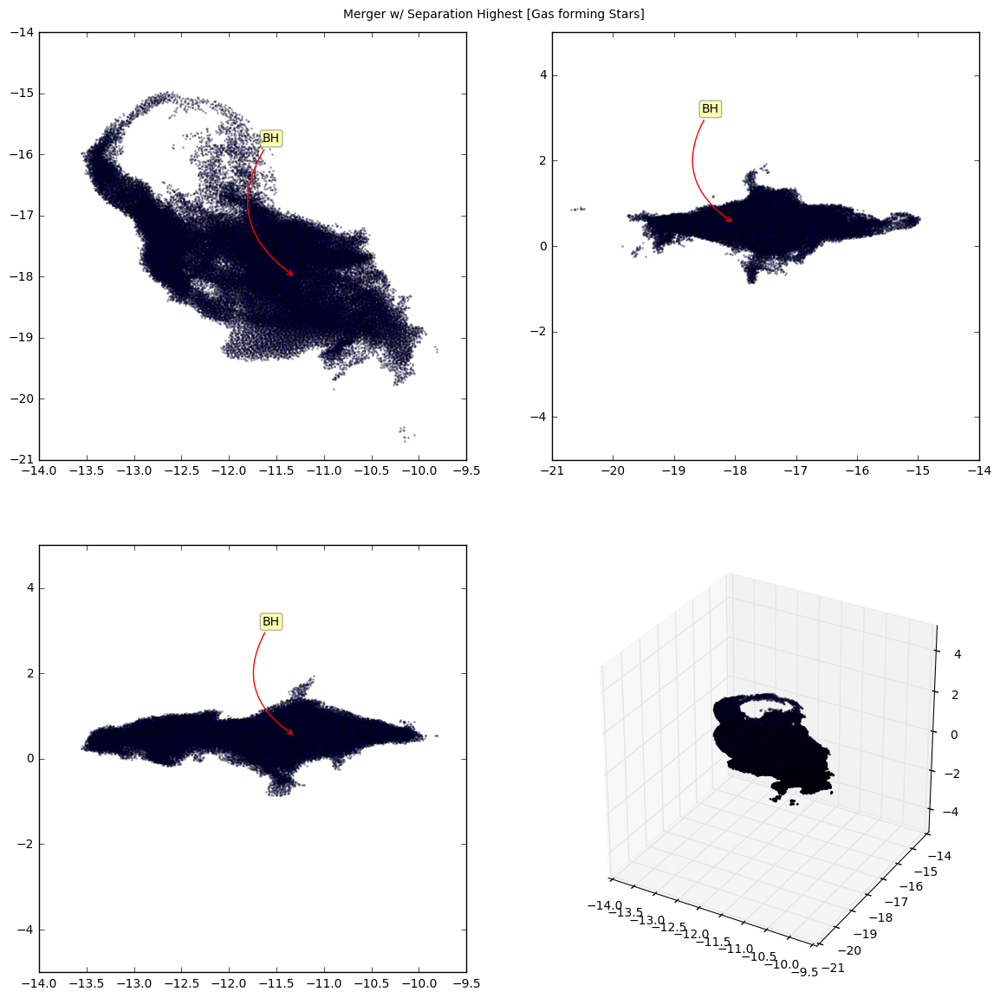

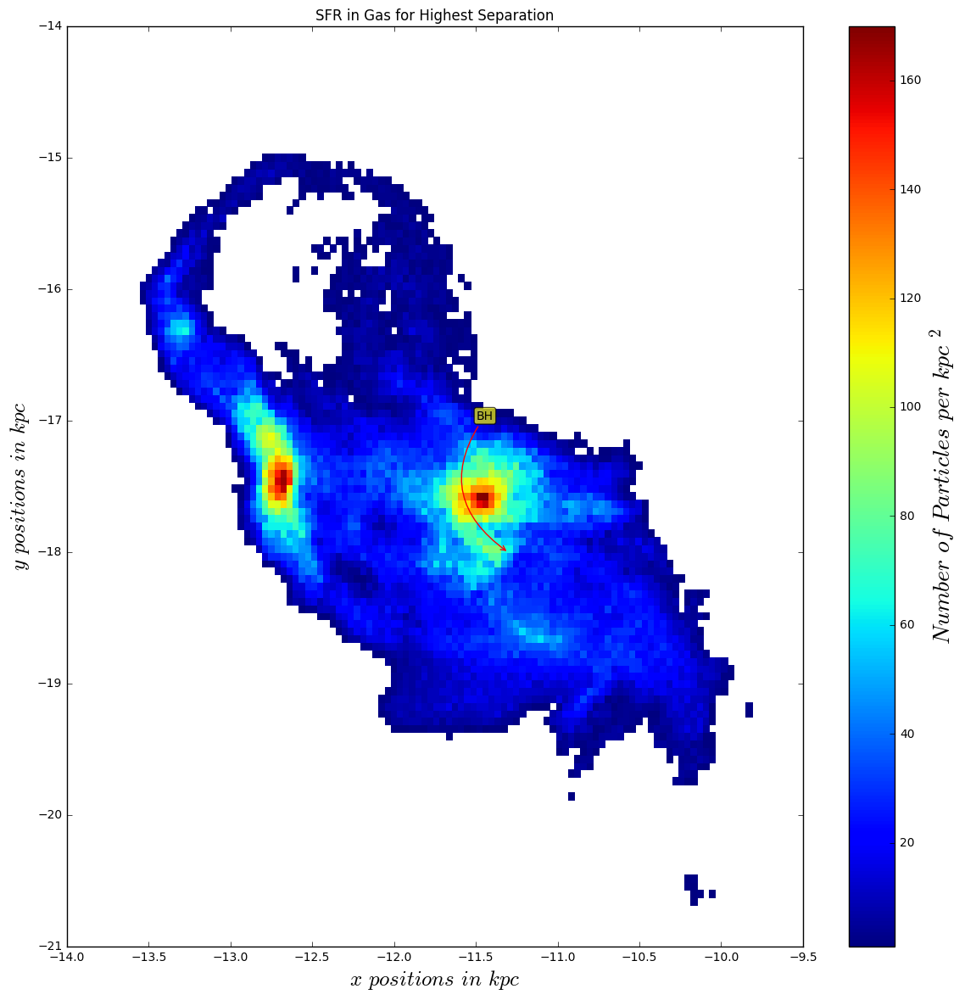

In [21]:
px = pos[:,0] / 0.73
py = pos[:,1] / 0.73
pz = pos[:,2] / 0.73


fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(2, 2)

p0 = fig.add_subplot(gs[0,0])
p0.scatter(px,py,s=1,c='b', alpha=0.3)
p0.annotate('BH', xy=(bhx1, bhy1), xytext=(-20,110), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
# p0.set_xlim(-400,400)
# p0.set_ylim(-5,-10)
p1 = fig.add_subplot(gs[0,1])
p1.scatter(py,pz,s=1,c='b', alpha=0.3)
p1.annotate('BH', xy=(bhy1, bhz1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
p1.set_ylim(-5,5)
p2 = fig.add_subplot(gs[1,0])
p2.scatter(px,pz,s=1,c='b', alpha=0.3)
p2.annotate('BH', xy=(bhx1, bhz1), xytext=(-20,90), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
p2.set_ylim(-5,5)
ax = fig.add_subplot(gs[1,1], projection='3d')
ax.scatter(px,py,pz, s=1, c='b', depthshade = 5)
# ax.set_xlim3d(-25,5)
# ax.set_ylim3d(-45,5)
ax.set_zlim3d(-5,5)
plt.suptitle('Merger w/ Separation Highest [Gas forming Stars]', y = 0.92)
plt.savefig('GasFormingStarswhenHighestSep')
# plt.savefig('Separation Highest Gas')



nbins = 100
xmin =
xmax =
ymin =
ymax =

H, xedges, yedges = np.histogram2d(px,py,bins=nbins, xmin=xmin, xmax=xmax,  )
binarea = (xmax-xmin)/nbins *
H = H*1.0/binarea
# H needs to be rotated and flipped
H = np.rot90(H)
H = np.flipud(H)
# Mask zeros
Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero 
# Plot 2D histogram using pcolor, pcolormesh shows actual edges
fig2 = plt.figure(figsize=(14,14))
plt.pcolormesh(xedges,yedges,Hmasked)
plt.xlabel('$x$ $positions$ $in$ $kpc$', size = 18)
plt.ylabel('$y$ $positions$ $in$ $kpc$', size = 18)
plt.title('SFR in Gas for Highest Separation')
plt.annotate('BH', xy=(bhx1, bhy1), xytext=(-20,111), 
            textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
cbar = plt.colorbar()
cbar.ax.set_ylabel('$Number$ $of$ $Particles$ $per$ $kpc$ $^{2}$', fontsize= 20)
plt.savefig('SFRinGasHighestSep')

# Make Plots for Movies #

# Plots for Stars in Galaxy Movie

In [ ]:
end = 402.0
snap = np.arange(0.0,end)
blah = []

for x in (snap):
    print x
    if x == 0.0:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
        
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
#         nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
#         n_positions = np.asarray(nstars['Coordinates'])
#         n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])

        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        fig = plt.figure(figsize=(14,14))

        p0 = fig.add_subplot(111)
        p0.scatter(sx,sy,s=1,c='b', alpha=0.3, label = str(x)+'Myr')
        p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
            fontsize =20, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.6),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        p0.set_xlabel('$x$ $positions$ $in$ $kpc$', size = 32)
        p0.set_ylabel('$y$ $positions$ $in$ $kpc$', size = 32)
        p0.set_ylim(-20,20)
        p0.set_xlim(-20,20)
#         x=(x*10)/1000
        p0.text(10,15,r'$t=$'+str(((x*10)/1000))+'Gyrs', fontsize = 25)
        plt.suptitle('Stars in Dwarf Galaxy', y=0.95, fontsize=25)
#         plt.axis('equal')
        plt.savefig('file'+str(x)+'.png')
       

    else:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
        nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
        n_positions = np.asarray(nstars['Coordinates'])
        n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])
        
        Gcom = findCenterMass(s_positions,s_mass)
        
        s_positions = s_positions - Gcom
        BH_positions = BH_positions - Gcom
        
        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        fig = plt.figure(figsize=(14,14))

        p0 = fig.add_subplot(111)
        p0.scatter(sx,sy,s=1,c='b', alpha=0.3, label = str(x)+'Myr')
        p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
            fontsize =20, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.6),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        p0.set_xlabel('$x$ $positions$ $kpc$', size = 32)
        p0.set_ylabel('$y$ $positions$ $kpc$', size = 32)
        p0.set_ylim(-20,20)
        p0.set_xlim(-20,20)
#         x=(x*10)/1000
        p0.text(10,15,r'$t=$'+str(((x*10)/1000))+'Gyrs', fontsize=28)
        plt.suptitle('Stars in Dwarf Galaxy', y= 0.95, fontsize=25)
#         plt.axis('equal')
        number = '%03d'%x
        plt.savefig('file'+number+'.png')   
        

0.0
1.0
2.0
3.0
4.0
5.0
6.0
7.0
8.0
9.0
10.0
11.0


# Plots for Stars in Galaxy Histogram Movie

0.0
1.0
2.0
3.0
4.0
5.0
6.0
7.0
8.0
9.0
10.0
11.0
12.0
13.0
14.0
15.0
16.0
17.0
18.0
19.0
20.0


/scda/pkg/devel/python/2.7.12/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


21.0
22.0
23.0
24.0
25.0
26.0
27.0
28.0
29.0
30.0
31.0
32.0
33.0
34.0
35.0
36.0
37.0
38.0
39.0
40.0
41.0
42.0
43.0
44.0
45.0
46.0
47.0
48.0
49.0
50.0
51.0
52.0
53.0
54.0
55.0
56.0
57.0
58.0
59.0
60.0
61.0
62.0
63.0
64.0
65.0
66.0
67.0
68.0
69.0
70.0
71.0
72.0
73.0
74.0
75.0
76.0
77.0
78.0
79.0
80.0
81.0
82.0
83.0
84.0
85.0
86.0
87.0
88.0
89.0
90.0
91.0
92.0
93.0
94.0
95.0
96.0
97.0
98.0
99.0
100.0
101.0
102.0
103.0
104.0
105.0
106.0
107.0
108.0
109.0
110.0
111.0
112.0
113.0
114.0
115.0
116.0
117.0
118.0
119.0
120.0
121.0
122.0
123.0
124.0
125.0
126.0
127.0
128.0
129.0
130.0
131.0
132.0
133.0
134.0
135.0
136.0
137.0
138.0
139.0
140.0
141.0
142.0
143.0
144.0
145.0
146.0
147.0
148.0
149.0
150.0
151.0
152.0
153.0
154.0
155.0
156.0
157.0
158.0
159.0
160.0
161.0
162.0
163.0
164.0
165.0
166.0
167.0
168.0
169.0
170.0
171.0
172.0
173.0
174.0
175.0
176.0
177.0
178.0
179.0
180.0
181.0
182.0
183.0
184.0
185.0
186.0
187.0
188.0
189.0
190.0
191.0
192.0
193.0
194.0
195.0
196.0
197.0
198.0
199.0
200.0

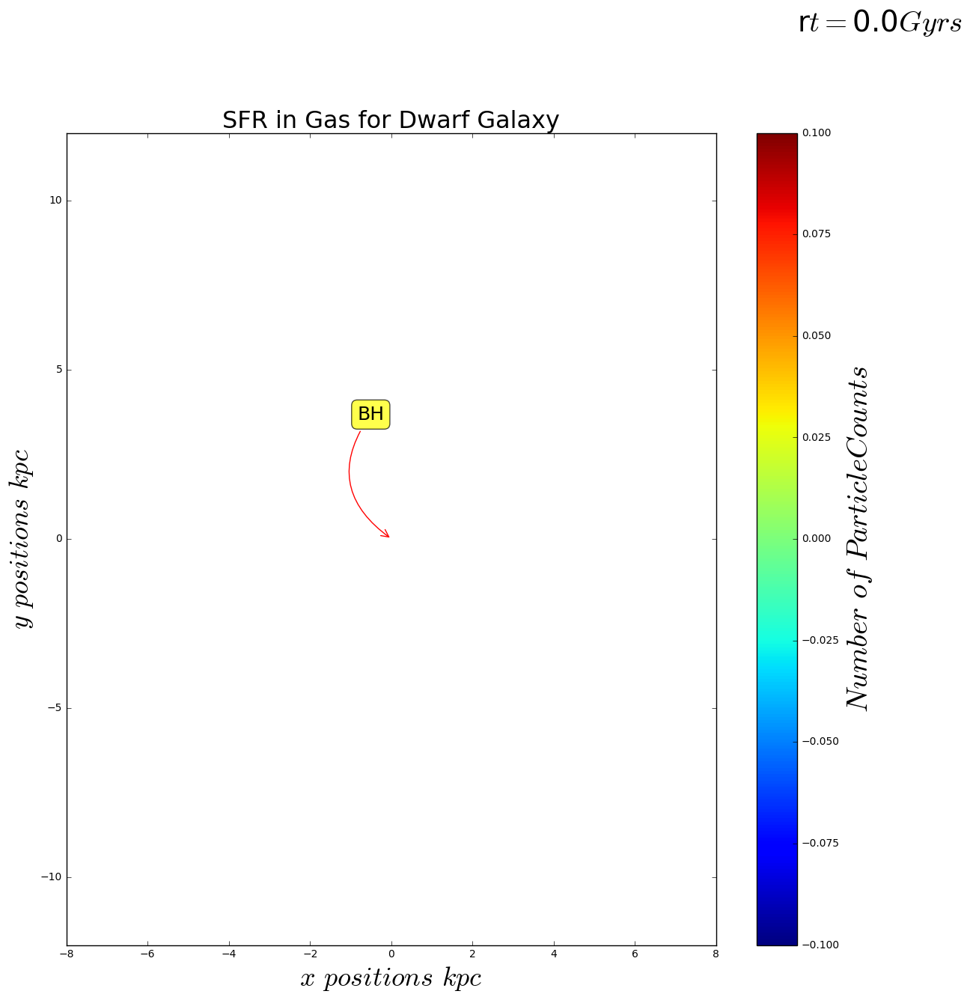

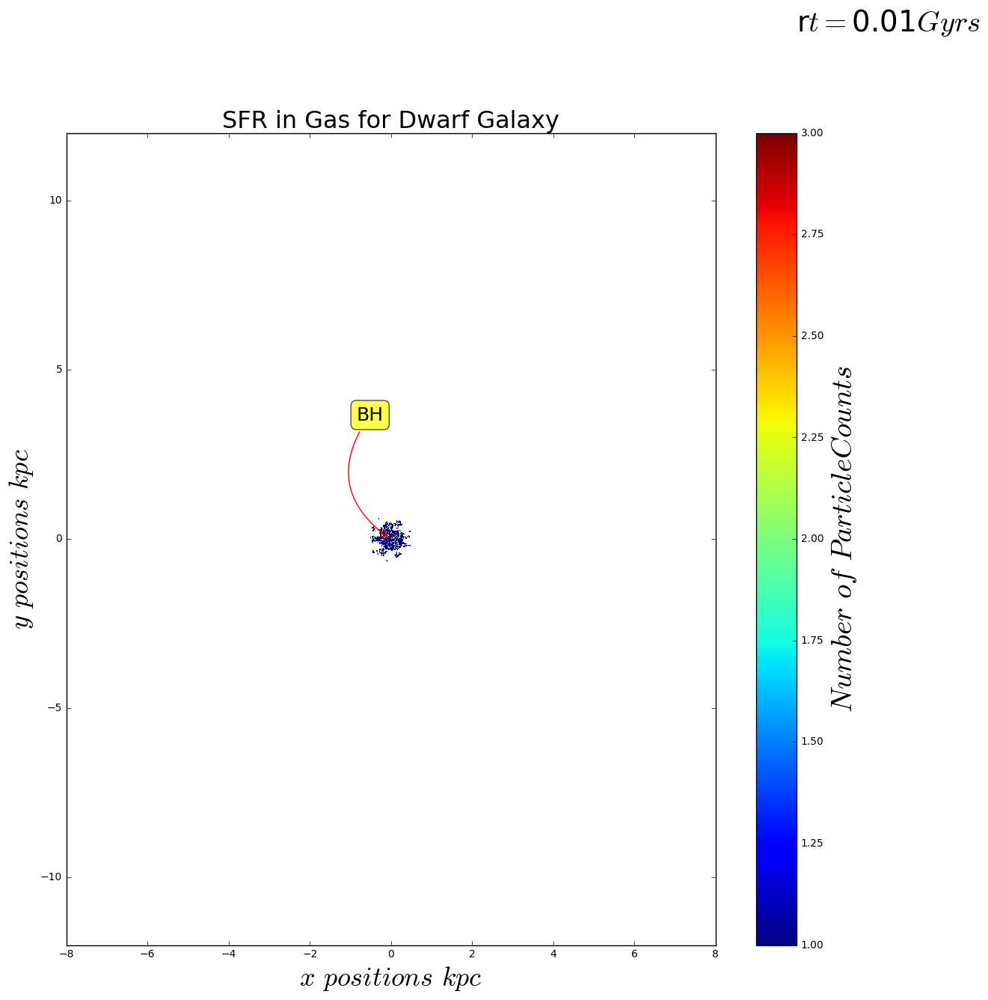

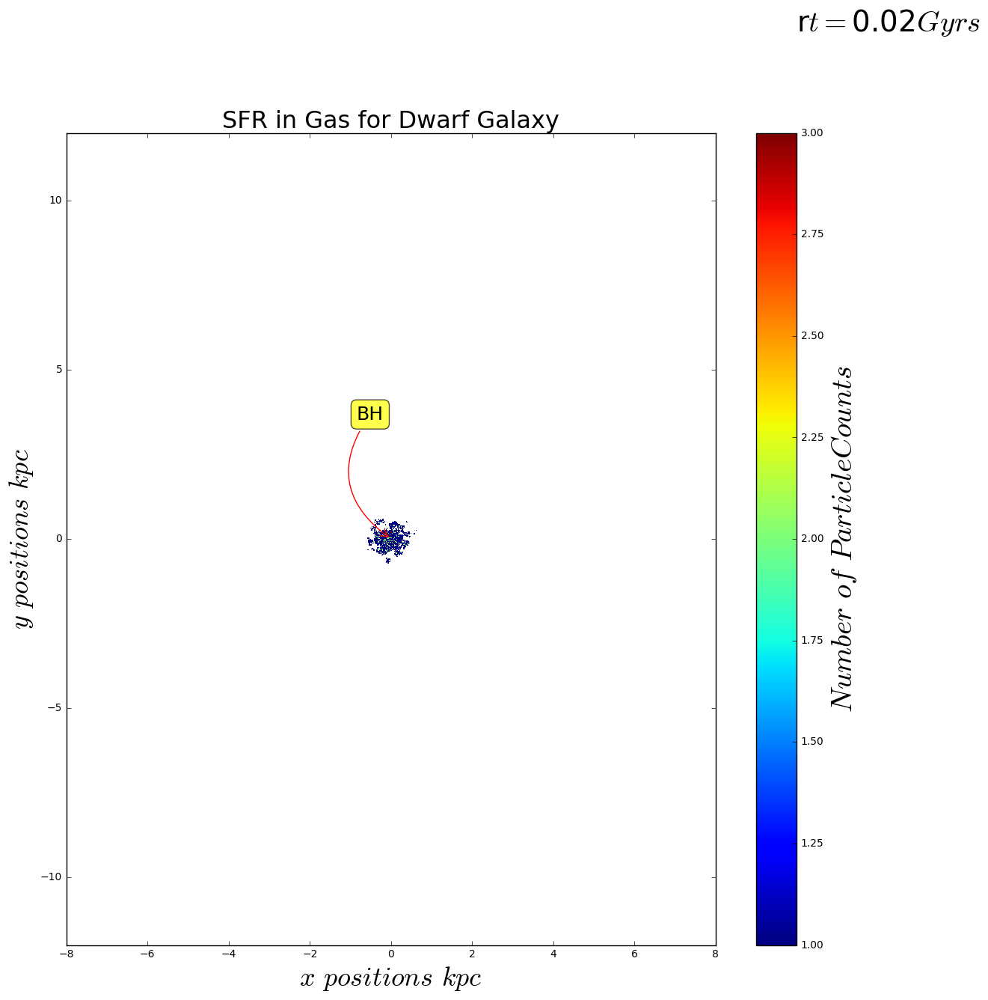

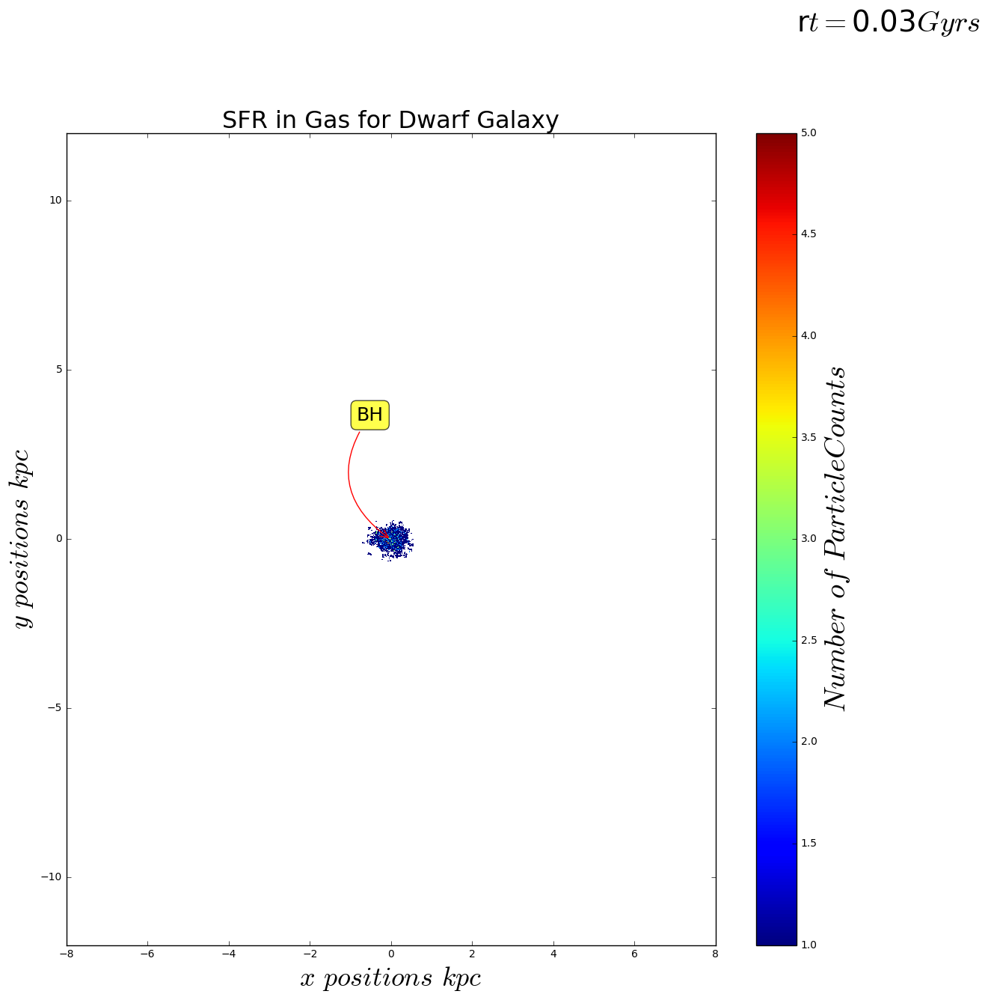

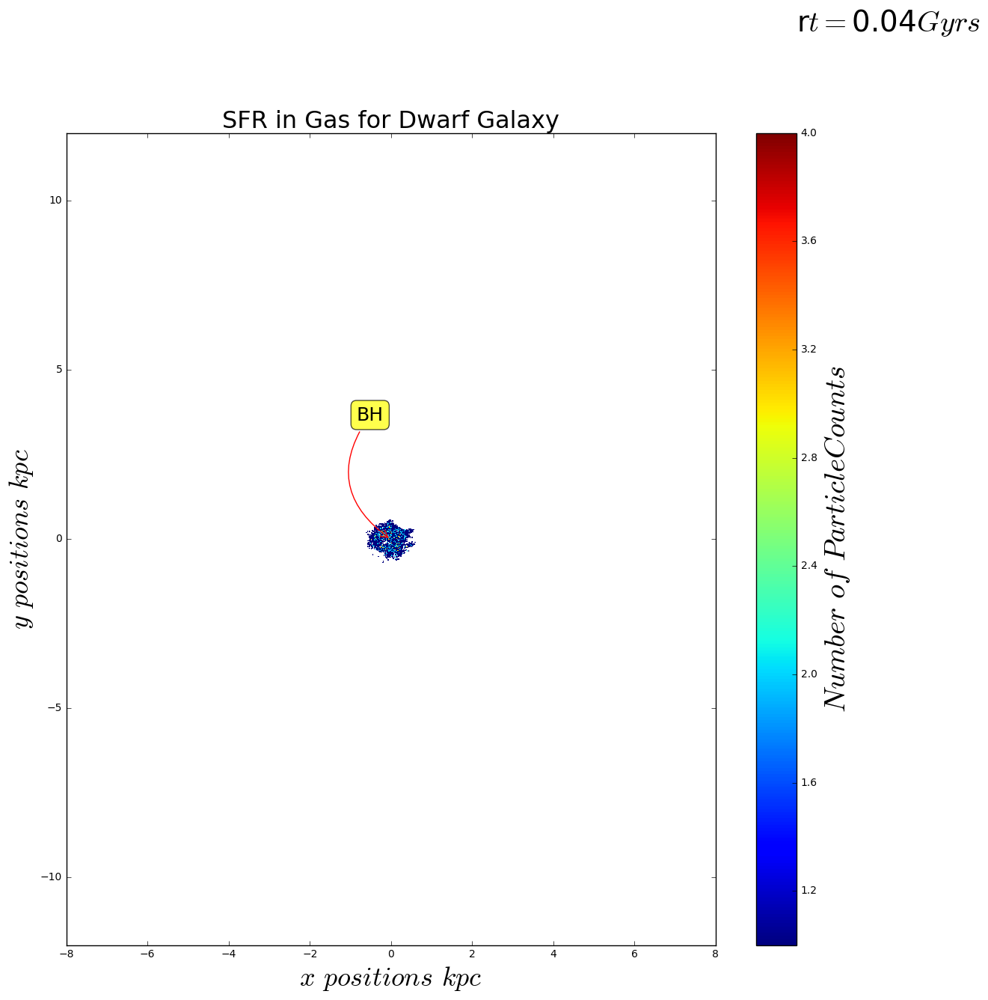

...

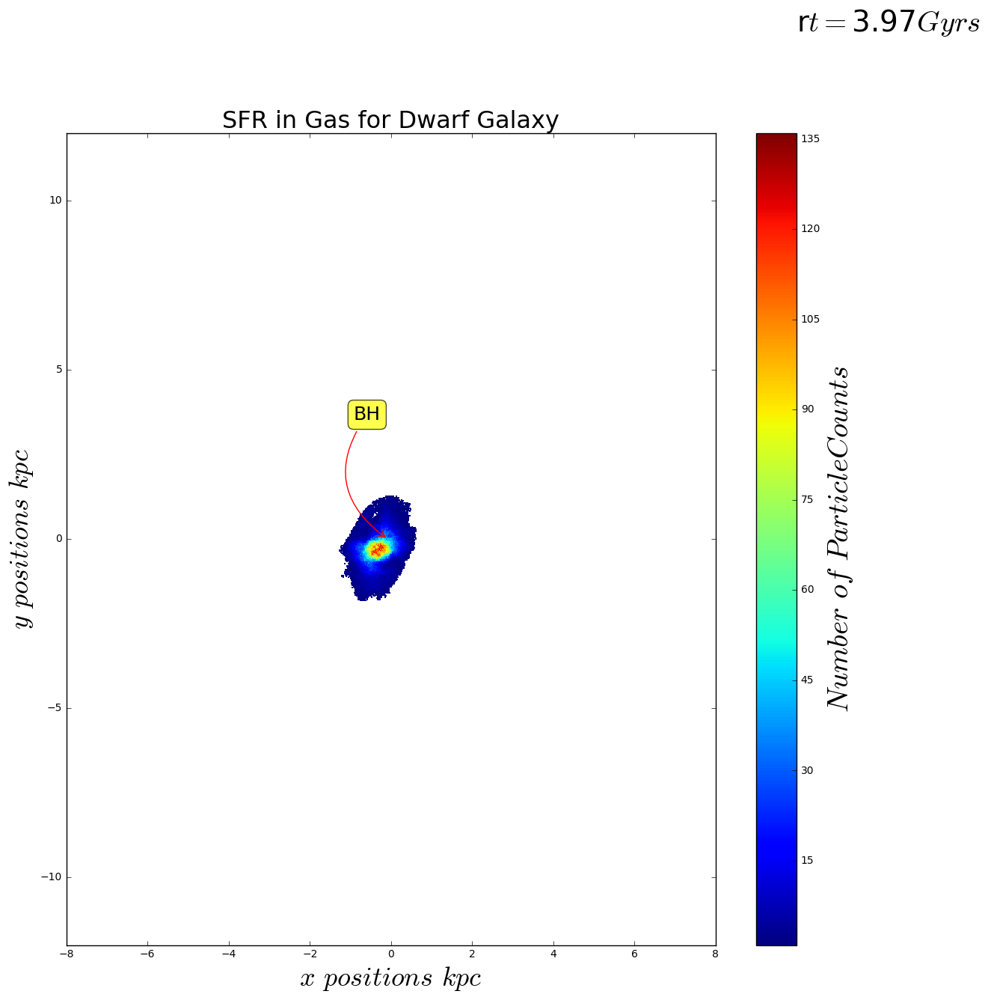

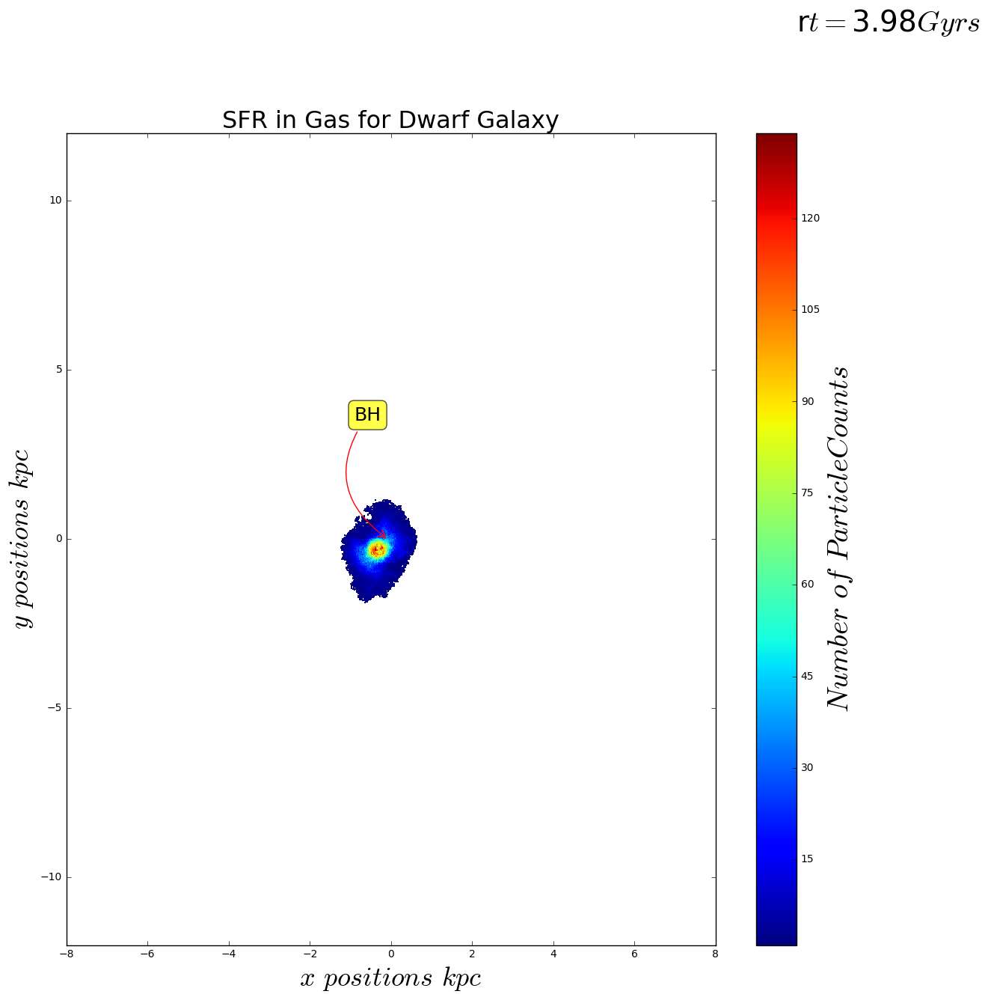

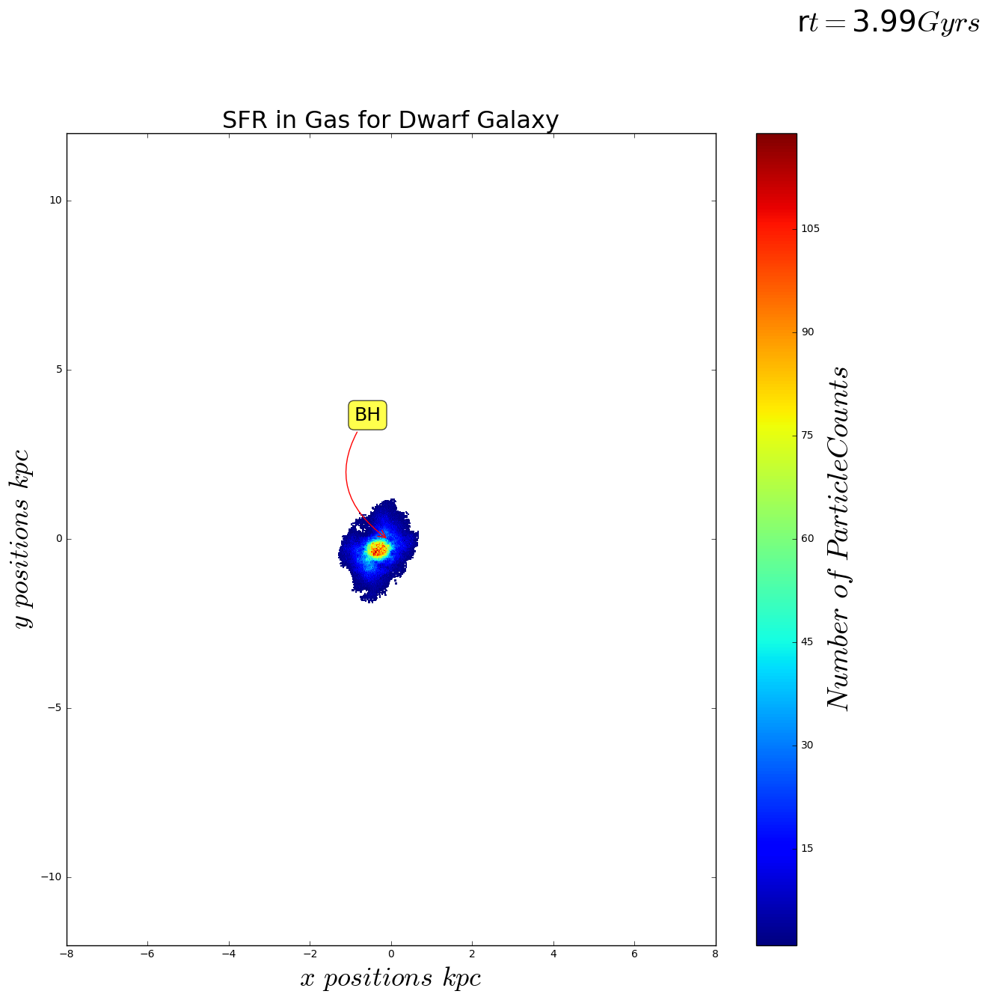

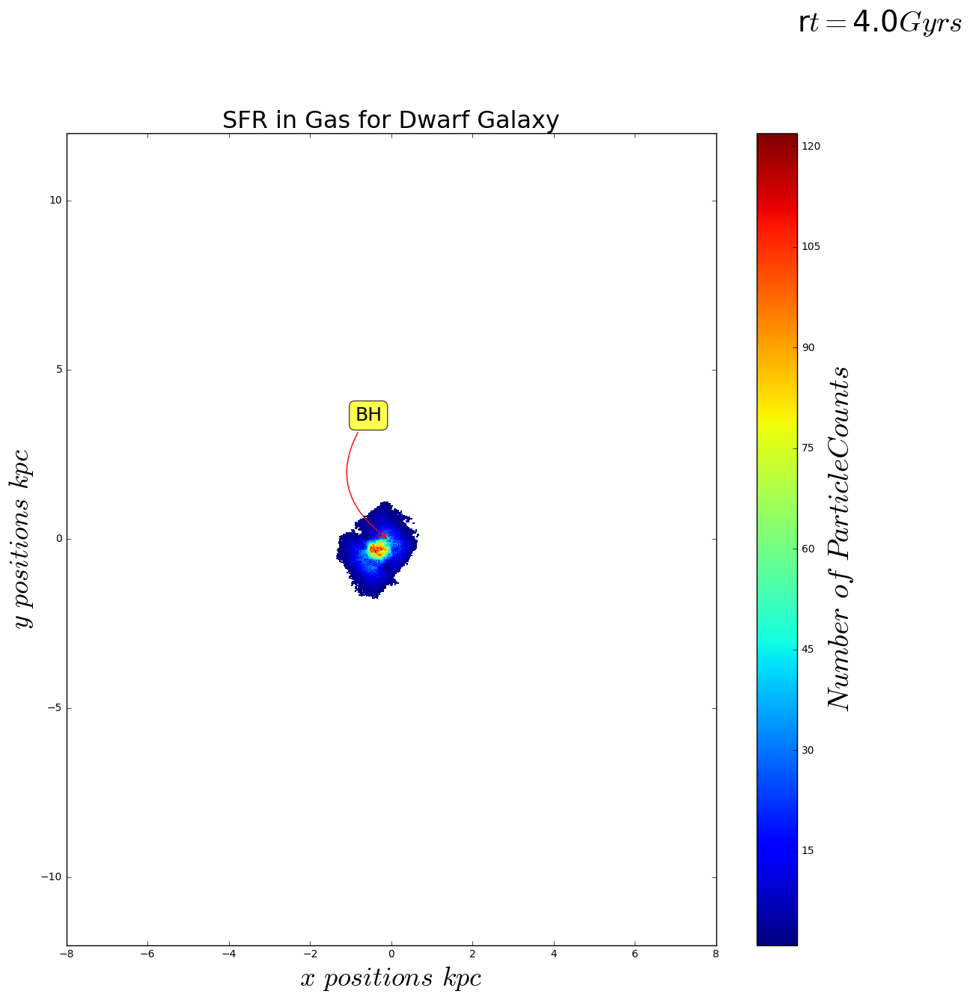

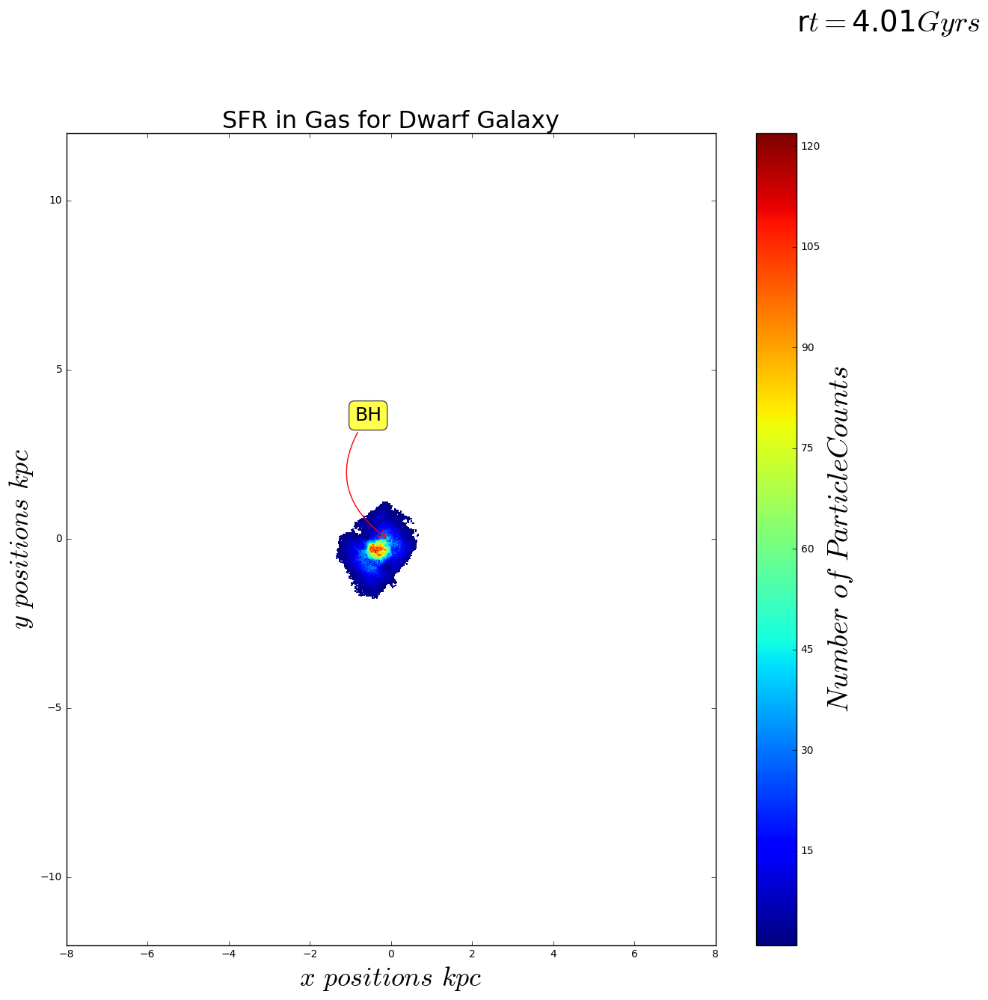

In [4]:
end = 402.0
snap = np.arange(0,end)
blah = []

for x in (snap):
    print x
    if x == 0.0:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
        
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
#         nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
#         n_positions = np.asarray(nstars['Coordinates'])
#         n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])

        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        sfr2 = np.asarray(gas['StarFormationRate'])
        pos = g_positions
#sfr1 = np.where(sfr2>0)
        sfr = sfr2[(sfr2>0)]
        pos = pos[(sfr2>0)]
        px = pos[:,0] / 0.73
        py = pos[:,1] / 0.73
        pz = pos[:,2] / 0.73


        nbins = 100
        H, xedges, yedges = np.histogram2d(px,py,bins=nbins)
# H needs to be rotated and flipped
        H = np.rot90(H)
        H = np.flipud(H)
# Mask zeros
        Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero 
# Plot 2D histogram using pcolor, pcolormesh shows actual edges
        fig2 = plt.figure(figsize=(14,14))
        plt.pcolormesh(xedges,yedges,Hmasked)
        plt.xlabel('$x$ $positions$ $kpc$', size = 26)
        plt.ylabel('$y$ $positions$ $kpc$', size = 26)
#         plt.xlim(-1,1)
#         plt.ylim(-1,1)
        plt.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        plt.xlim(-8,8)
        plt.ylim(-12,12)
        plt.annotate('BH', xy=(bhx, bhy), xytext=(-20,111), 
            fontsize=18,textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        cbar = plt.colorbar()
        cbar.ax.set_ylabel('$Number$ $of$ $ Particle Counts$', fontsize= 28) #$per$ $kpc$ $^{2}$
#         plt.axis('equal')
        plt.text(10,15,'r$t=$'+str(((x*10)/1000))+'$Gyrs$', fontsize=28)
        
#         fig = plt.figure(figsize=(14,14))

#         p0 = fig.add_subplot(111)
#         p0.scatter(sx,sy,s=1,c='b', alpha=0.3)
#         p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.6),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
#         p0.set_xlabel('X [kpc/h]')
#         p0.set_ylabel('Y [kpc/h]')
#         plt.suptitle('Dwarf Galaxy Plot', y=0.92)
        plt.savefig('histfile'+str(x)+'.png')
       

    else:
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
        nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
        n_positions = np.asarray(nstars['Coordinates'])
        g_mass = np.asarray(gas['Mass'])
        n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])
        
        Gcom = findCenterMass(s_positions,s_mass)
        
        s_positions = s_positions - Gcom
        BH_positions = BH_positions - Gcom
        g_positions = g_positions - findCenterMass(g_positions,g_mass)
        
        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        sfr2 = np.asarray(gas['StarFormationRate'])
        pos = g_positions
#sfr1 = np.where(sfr2>0)
        sfr = sfr2[(sfr2>0)]
        pos = pos[(sfr2>0)]
        px = pos[:,0] / 0.73
        py = pos[:,1] / 0.73
        pz = pos[:,2] / 0.73


        nbins = 100
        H, xedges, yedges = np.histogram2d(px,py,bins=nbins, weights=sfr)
# H needs to be rotated and flipped
        H = np.rot90(H)
        H = np.flipud(H)
# Mask zeros
        Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero 
# Plot 2D histogram using pcolor, pcolormesh shows actual edges
        fig2 = plt.figure(figsize=(14,14))
        plt.pcolormesh(xedges,yedges,Hmasked)
        plt.xlabel('$x$ $positions$ $kpc$', size = 26)
        plt.ylabel('$y$ $positions$ $kpc$', size = 26)
        plt.xlim(-8,8)
        plt.ylim(-12,12)
        plt.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        plt.annotate('BH', xy=(bhx, bhy), xytext=(-20,111), 
            fontsize=18,textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        plt.text(10,15,'r$t=$'+str(((x*10)/1000))+'$Gyrs$', fontsize=28)
        cbar = plt.colorbar()
        cbar.ax.set_ylabel('$Number$ $of$ $ Particle Counts$', fontsize= 28) #$per$ $kpc$ $^{2}$
    
#         fig = plt.figure(figsize=(14,14))

#         p0 = fig.add_subplot(111)
#         p0.scatter(sx,sy,s=1,c='b', alpha=0.3)
#         p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,150), 
#             textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.2', fc='yellow', alpha=0.6),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
#         p0.set_xlabel('X [kpc/h]')
#         p0.set_ylabel('Y [kpc/h]')
#         plt.suptitle('Dwarf Galaxy Plot', y= 0.92)
        plt.savefig('histfile'+str(x)+'.png')  

# Testing Grid Movie Plots

0


RuntimeError: No mappable was found to use for colorbar creation. First define a mappable such as an image (with imshow) or a contour set (with contourf).

/scda/pkg/devel/python/2.7.12/lib/python2.7/site-packages/numpy/ma/core.py:4185: UserWarning: Warning: converting a masked element to nan.
  warnings.warn("Warning: converting a masked element to nan.")


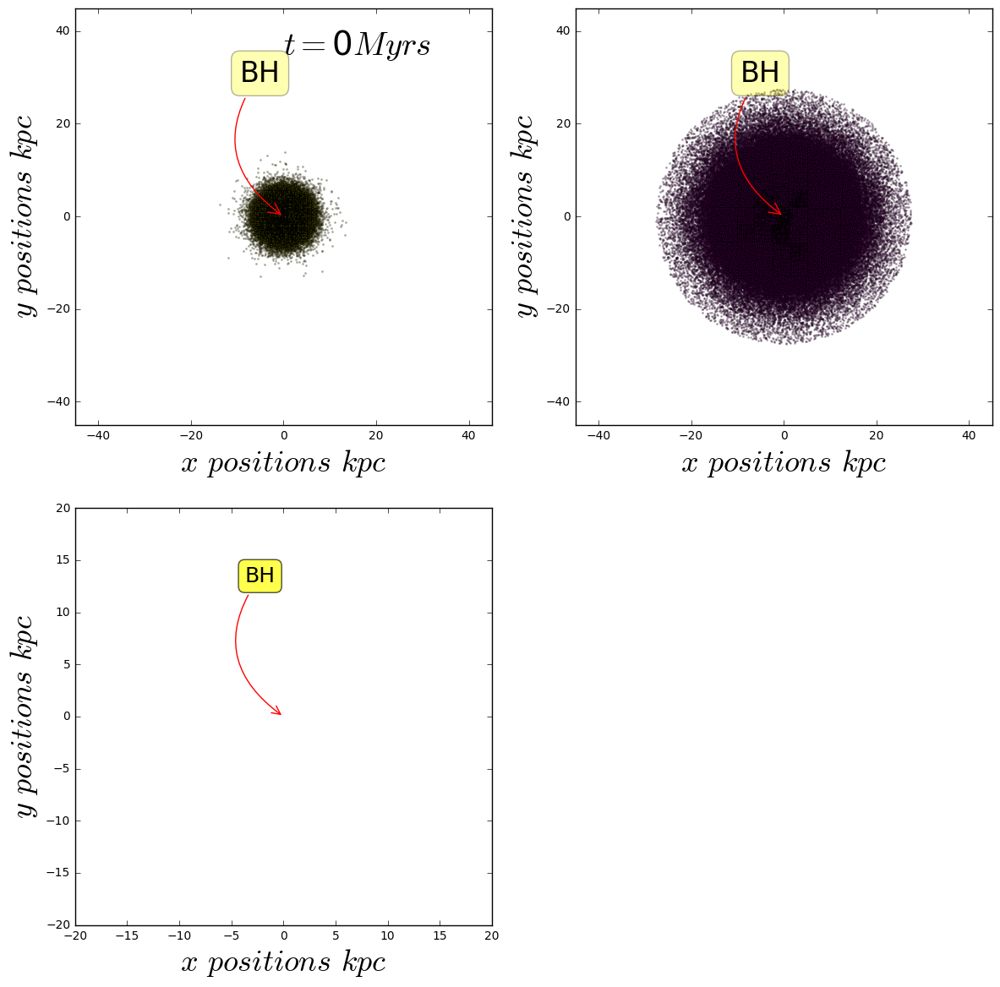

In [4]:
end = 402
snap = np.arange(0,end)
blah = []
fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(2, 2)

for x in (snap):
    print x
    if x == 0:
        fig = plt.figure(figsize=(14,14))
        gs = gridspec.GridSpec(2, 2)
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
        
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
#         nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
#         n_positions = np.asarray(nstars['Coordinates'])
#         n_mass = np.asarray(nstars['Mass'])
        g_mass = np.asarray(gas['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])

        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        sfr2 = np.asarray(gas['StarFormationRate'])
        pos = g_positions
#sfr1 = np.where(sfr2>0)
        sfr = sfr2[(sfr2>0)]
        pos = pos[(sfr2>0)] - findCenterMass(np.concatenate((s_positions,g_positions),axis=0),np.concatenate((s_mass,g_mass),axis=0))
        px = pos[:,0] / 0.73
        py = pos[:,1] / 0.73
        pz = pos[:,2] / 0.73
        

        nbins = 100
        H, xedges, yedges = np.histogram2d(px,py,bins=nbins)
# H needs to be rotated and flipped
        H = np.rot90(H)
        H = np.flipud(H)
# Mask zeros
        Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero 
# Plot 2D histogram using pcolor, pcolormesh shows actual edges        
        p0 = fig.add_subplot(gs[0,0])
        p0.scatter(sx,sy,s=1,c='y', alpha=0.3)
        p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
            fontsize=24, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        p0.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p0.set_ylabel('$y$ $positions$ $kpc$', size = 26)
        p0.set_xlim(-45,45)
        p0.set_ylim(-45,45)
        p0.text(0,35,r'$t=$'+str(x)+'$Myrs$', fontsize=28)
        

        p1 = fig.add_subplot(gs[0,1])
        p1.scatter(gx,gy,s=1,c='m', alpha=0.3)
        p1.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
            fontsize=24, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
                
        
        p1.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p1.set_ylabel('$y$ $positions$ $kpc$', size = 26)
        p1.set_xlim(-45,45)
        p1.set_ylim(-45,45)
#         p1.text(0,35,'r$t=$'+str(x)+'$Myrs$', fontsize=28)
        
        
        p2 = fig.add_subplot(gs[1,0])
        p2.pcolormesh(xedges,yedges,Hmasked)
        p2.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p2.set_ylabel('$y$ $positions$ $kpc$', size = 26)
        p2.set_xlim(-20,20)
        p2.set_ylim(-20,20)
#         p2.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        p2.annotate('BH', xy=(bhx, bhy), xytext=(-20,111), 
            fontsize=18,textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
#         plt.text(10,15,'r$t=$'+str(x)+'$Myrs$', fontsize=28)
        cbar = plt.colorbar()
#         p2.text(0,35,'r$t=$'+str(x)+'$Myrs$', fontsize=28)
        
        
        ax = fig.add_subplot(gs[1,1], projection='3d')
        ax.scatter(gx,gy,gz,s=0.2,c='y')
        ax.scatter(sx,sy,sz,s=0.3,c='r')
#         ax.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
#             fontsize=24, textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
# #         plt.xlim(-1,1)
# #         plt.ylim(-1,1)
#         plt.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        ax.set_xlim3d(-45,45)
        ax.set_ylim3d(-45,45)
        ax.set_zlim3d(-45,45)
#         plt.suptitle('Dwarf Galaxy Plot', y=0.92)
        plt.savefig('testfile'+str(x)+'.png')
       

    else:
        fig = plt.figure(figsize=(14,14))
        gs = gridspec.GridSpec(2, 2)
        filein = h5.File("/mnt/ceph/users/tstarkenburg/BH-DATA/forJonathan/Merger/data/snapshot_%03d/snap_%03d.hdf5" %(x,x),'r')
    
        header = filein['Header']
        gas = filein['PartType0']
        stars = filein['PartType2']
        nstars = filein['PartType4']
        g_positions = np.asarray(gas['Coordinates'])
        s_positions = np.asarray(stars['Coordinates'])
        n_positions = np.asarray(nstars['Coordinates'])
        g_mass = np.asarray(gas['Mass'])
        n_mass = np.asarray(nstars['Mass'])
        s_mass = np.ones(500000)*(header.attrs.__getitem__('MassTable')[2])
        BH = filein['PartType5']
        BH_positions = np.asarray(BH['Coordinates'])
        
        Gcom = findCenterMass(s_positions,s_mass)
        
        s_positions = s_positions - Gcom
        BH_positions = BH_positions - findCenterMass(np.concatenate((s_positions,g_positions),axis=0),np.concatenate((s_mass,g_mass),axis=0))
        g_positions = g_positions - findCenterMass(g_positions,g_mass)
        
        bhx = BH_positions[:,0] / 0.73
        bhy = BH_positions[:,1] / 0.73
        bhz = BH_positions[:,2] / 0.73
        gx = g_positions[:,0] / 0.73
        gy = g_positions[:,1] / 0.73
        gz = g_positions[:,2] / 0.73
        sx = s_positions[:,0] / 0.73
        sy = s_positions[:,1] / 0.73
        sz = s_positions[:,2] / 0.73
        
        sfr2 = np.asarray(gas['StarFormationRate'])
        pos = g_positions
#sfr1 = np.where(sfr2>0)
        sfr = sfr2[(sfr2>0)]
        pos = pos[(sfr2>0)] - findCenterMass(np.concatenate((s_positions,g_positions),axis=0),np.concatenate((s_mass,g_mass),axis=0))
        px = pos[:,0] / 0.73
        py = pos[:,1] / 0.73
        pz = pos[:,2] / 0.73


        nbins = 100
        H, xedges, yedges = np.histogram2d(px,py,bins=nbins)
# H needs to be rotated and flipped
        H = np.rot90(H)
        H = np.flipud(H)
# Mask zeros
        Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value of zero 
# Plot 2D histogram using pcolor, pcolormesh shows actual edges
        p0 = fig.add_subplot(gs[0,0])
        p0.scatter(sx,sy,s=1,c='y', alpha=0.3)
        p0.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
            fontsize=24, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        
        p0.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p0.set_ylabel('$y$ $positions$ $kpc$', size = 26)
# #         plt.xlim(-1,1)
# #         plt.ylim(-1,1)
#         plt.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        p0.set_xlim(-45,45)
        p0.set_ylim(-45,45)
        p0.text(0,35,r'$t=$'+str(x)+'$Myrs$', fontsize=28)
#         p0.
        
        
        p1 = fig.add_subplot(gs[0,1])
        p1.scatter(gx,gy,s=1,c='m', alpha=0.3)
        p1.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
            fontsize=24, textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
        p1.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p1.set_ylabel('$y$ $positions$ $kpc$', size = 26)
        p1.set_xlim(-45,45)
        p1.set_ylim(-45,45)
#         p1.text(0,35,r'$t=$'+str(x)+'$Myrs$', fontsize=28)


    
        p2 = fig.add_subplot(gs[1,0])
        p2.pcolormesh(xedges,yedges,Hmasked)
        p2.set_xlabel('$x$ $positions$ $kpc$', size = 26)
        p2.set_ylabel('$y$ $positions$ $kpc$', size = 26)
        p2.set_xlim(-20,20)
        p2.set_ylim(-20,20)
#         p2.title('SFR in Gas for Dwarf Galaxy', fontsize=23)
        p2.annotate('BH', xy=(bhx, bhy), xytext=(-20,111), 
            fontsize=18,textcoords='offset points', ha='center', va='bottom',
            bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.7),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
                            color='red'))
#         plt.text(10,15,'r$t=$'+str(x)+'$Myrs$', fontsize=28)
#         cbar = plt.colorbar()
#         p2.scatter(px,py,s=0.5,c='b', alpha=0.3)
#         p2.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
#             fontsize=24, textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
#         p2.set_xlabel('$x$ $positions$ $kpc$', size = 26)
#         p2.set_ylabel('$y$ $positions$ $kpc$', size = 26)
#         p2.set_xlim(-45,45)
#         p2.set_ylim(-45,45)
#         p2.text(0,35,r'$t=$'+str(x)+'$Myrs$', fontsize=28)
        
        ax = fig.add_subplot(gs[1,1], projection='3d')
        ax.scatter(gx,gy,gz,s=0.2,c='y')
        ax.scatter(sx,sy,sz,s=0.3,c='r')
#         ax.annotate('BH', xy=(bhx, bhy), xytext=(-20,110), 
#             fontsize=24, textcoords='offset points', ha='center', va='bottom',
#             bbox=dict(boxstyle='round,pad=0.3', fc='yellow', alpha=0.3),
#             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5', 
#                             color='red'))
        ax.set_xlim3d(-45,45)
        ax.set_ylim3d(-45,45)
        ax.set_zlim3d(-45,45)        
        
#     plt.suptitle('Dwarf Galaxy Plot', y=0.92)
        plt.savefig('testfile'+str(x)+'.png')  